In [464]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import chain
from scipy.stats import normaltest, norm, kstest, t
from scipy.optimize import minimize
from copy import copy, deepcopy
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.preprocessing import StandardScaler, KBinsDiscretizer, PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA

import bamt.Networks as Nets
import bamt.Preprocessors as pp

from sklearn import preprocessing
from pgmpy.estimators import K2Score


import warnings
warnings.filterwarnings('ignore')

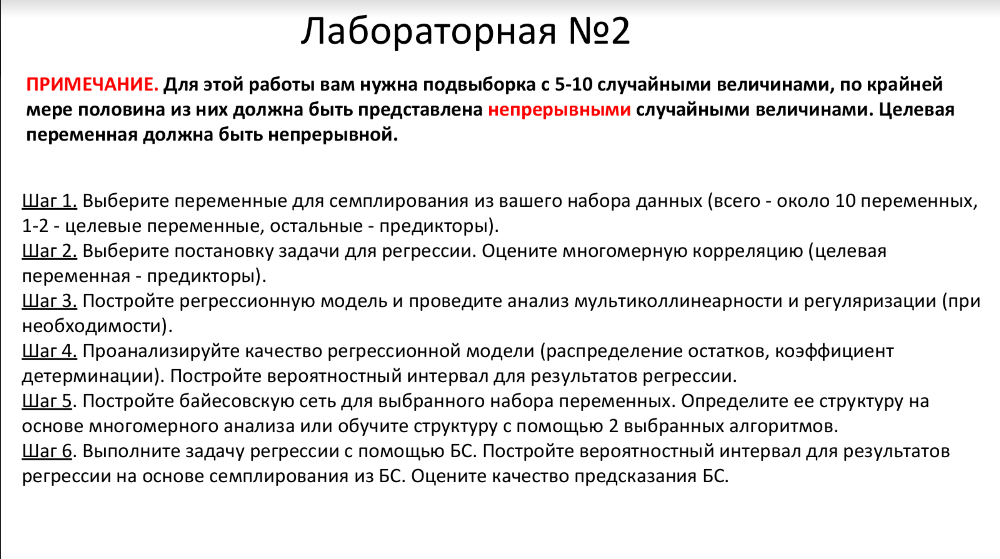

# Step 1-2. Variabels choice, regression task

In [465]:
data = pd.read_csv('song_data.csv')

In [466]:
data.head(5)

,song_name,song_popularity,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
0,Boulevard of Broken Dreams,73,262333,0.005520,0.496,0.682,0.000029,8,0.0589,-4.095,1,0.0294,167.060,4,0.474
1,In The End,66,216933,0.010300,0.542,0.853,0.000000,3,0.1080,-6.407,0,0.0498,105.256,4,0.370
2,Seven Nation Army,76,231733,0.008170,0.737,0.463,0.447000,0,0.2550,-7.828,1,0.0792,123.881,4,0.324
3,By The Way,74,216933,0.026400,0.451,0.970,0.003550,0,0.1020,-4.938,1,0.1070,122.444,4,0.198
4,How You Remind Me,56,223826,0.000954,0.447,0.766,0.000000,10,0.1130,-5.065,1,0.0313,172.011,4,0.574


In [467]:
data.shape

(18835, 15)

In [468]:
data = data.drop_duplicates(keep="first", ignore_index=True)

In [469]:
data.shape

(14926, 15)

In [470]:
data = data.drop(columns=['song_name'])
data.shape

(14926, 14)

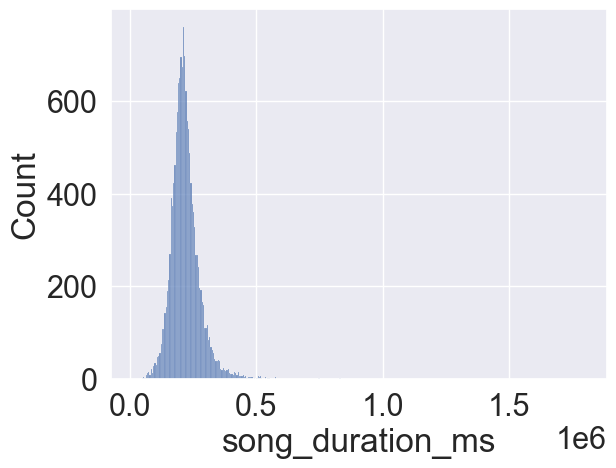

In [471]:
sns.histplot(data=data.song_duration_ms, label='song_duration_ms')
plt.show()

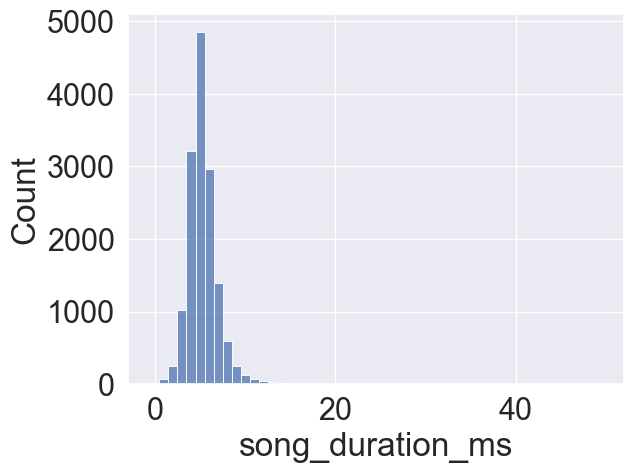

In [472]:
est = KBinsDiscretizer(n_bins=50, encode='ordinal', strategy='uniform')
est.fit(data.song_duration_ms.values.reshape(-1, 1))
data.song_duration_ms = est.transform(data.song_duration_ms.values.reshape(-1, 1))
sns.histplot(data=data.song_duration_ms, discrete=True, label='song_duration_ms')
plt.show()

In [473]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14926 entries, 0 to 14925
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   song_popularity   14926 non-null  int64  
 1   song_duration_ms  14926 non-null  float64
 2   acousticness      14926 non-null  float64
 3   danceability      14926 non-null  float64
 4   energy            14926 non-null  float64
 5   instrumentalness  14926 non-null  float64
 6   key               14926 non-null  int64  
 7   liveness          14926 non-null  float64
 8   loudness          14926 non-null  float64
 9   audio_mode        14926 non-null  int64  
 10  speechiness       14926 non-null  float64
 11  tempo             14926 non-null  float64
 12  time_signature    14926 non-null  int64  
 13  audio_valence     14926 non-null  float64
dtypes: float64(10), int64(4)
memory usage: 1.6 MB


In [474]:
data.describe()

,song_popularity,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
count,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000
mean,48.750904,5.291907,0.270453,0.624514,0.639763,0.092067,5.301152,0.180435,-7.677232,0.631917,0.099419,121.105007,3.952968,0.526967
std,20.379465,1.765426,0.298117,0.158081,0.221756,0.240451,3.592616,0.145097,4.018670,0.482300,0.103546,29.044644,0.316702,0.247758
min,0.000000,0.000000,0.000001,0.000000,0.001070,0.000000,0.000000,0.010900,-38.768000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,37.000000,4.000000,0.023600,0.524000,0.496000,0.000000,2.000000,0.093000,-9.389500,0.000000,0.037200,98.125000,4.000000,0.332000
50%,52.000000,5.000000,0.139000,0.636000,0.672000,0.000021,5.000000,0.122000,-6.750500,1.000000,0.054100,120.016000,4.000000,0.527000
75%,63.750000,6.000000,0.458000,0.740000,0.818000,0.005105,8.000000,0.224000,-4.991000,1.000000,0.113000,139.940750,4.000000,0.727750
max,100.000000,49.000000,0.996000,0.987000,0.999000,0.997000,11.000000,0.986000,1.585000,1.000000,0.941000,242.318000,5.000000,0.984000


In [475]:
data['energy'] = data['energy'].mul(100)
data.describe()

,song_popularity,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
count,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000
mean,48.750904,5.291907,0.270453,0.624514,63.976253,0.092067,5.301152,0.180435,-7.677232,0.631917,0.099419,121.105007,3.952968,0.526967
std,20.379465,1.765426,0.298117,0.158081,22.175619,0.240451,3.592616,0.145097,4.018670,0.482300,0.103546,29.044644,0.316702,0.247758
min,0.000000,0.000000,0.000001,0.000000,0.107000,0.000000,0.000000,0.010900,-38.768000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,37.000000,4.000000,0.023600,0.524000,49.600000,0.000000,2.000000,0.093000,-9.389500,0.000000,0.037200,98.125000,4.000000,0.332000
50%,52.000000,5.000000,0.139000,0.636000,67.200000,0.000021,5.000000,0.122000,-6.750500,1.000000,0.054100,120.016000,4.000000,0.527000
75%,63.750000,6.000000,0.458000,0.740000,81.800000,0.005105,8.000000,0.224000,-4.991000,1.000000,0.113000,139.940750,4.000000,0.727750
max,100.000000,49.000000,0.996000,0.987000,99.900000,0.997000,11.000000,0.986000,1.585000,1.000000,0.941000,242.318000,5.000000,0.984000


In [476]:
data.describe()

,song_popularity,song_duration_ms,acousticness,danceability,energy,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
count,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000,14926.000000
mean,48.750904,5.291907,0.270453,0.624514,63.976253,0.092067,5.301152,0.180435,-7.677232,0.631917,0.099419,121.105007,3.952968,0.526967
std,20.379465,1.765426,0.298117,0.158081,22.175619,0.240451,3.592616,0.145097,4.018670,0.482300,0.103546,29.044644,0.316702,0.247758
min,0.000000,0.000000,0.000001,0.000000,0.107000,0.000000,0.000000,0.010900,-38.768000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,37.000000,4.000000,0.023600,0.524000,49.600000,0.000000,2.000000,0.093000,-9.389500,0.000000,0.037200,98.125000,4.000000,0.332000
50%,52.000000,5.000000,0.139000,0.636000,67.200000,0.000021,5.000000,0.122000,-6.750500,1.000000,0.054100,120.016000,4.000000,0.527000
75%,63.750000,6.000000,0.458000,0.740000,81.800000,0.005105,8.000000,0.224000,-4.991000,1.000000,0.113000,139.940750,4.000000,0.727750
max,100.000000,49.000000,0.996000,0.987000,99.900000,0.997000,11.000000,0.986000,1.585000,1.000000,0.941000,242.318000,5.000000,0.984000


In [477]:
target = data.energy
data = data.drop(columns=['energy'])

In [478]:
data.columns

Index(['song_popularity', 'song_duration_ms', 'acousticness', 'danceability',
       'instrumentalness', 'key', 'liveness', 'loudness', 'audio_mode',
       'speechiness', 'tempo', 'time_signature', 'audio_valence'],
      dtype='object')

In [479]:
data.head(5)

,song_popularity,song_duration_ms,acousticness,danceability,instrumentalness,key,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
0,73,7.0,0.005520,0.496,0.000029,8,0.0589,-4.095,1,0.0294,167.060,4,0.474
1,66,5.0,0.010300,0.542,0.000000,3,0.1080,-6.407,0,0.0498,105.256,4,0.370
2,76,6.0,0.008170,0.737,0.447000,0,0.2550,-7.828,1,0.0792,123.881,4,0.324
3,74,5.0,0.026400,0.451,0.003550,0,0.1020,-4.938,1,0.1070,122.444,4,0.198
4,56,5.0,0.000954,0.447,0.000000,10,0.1130,-5.065,1,0.0313,172.011,4,0.574


## Correlation

In [480]:
discrete_features = ['song_popularity', 'song_duration_ms', 'key', 'audio_mode', 'time_signature']
continuous_features = [col for col in data.columns if col not in discrete_features]

corrs = {}
for col in discrete_features:
    corrs.update({col: target.corr(data[col], method='spearman')})
for col in continuous_features:
    corrs.update({col: target.corr(data[col], method='pearson')})
    
corrs = pd.Series(corrs).sort_values()
print(corrs)

acousticness       -0.679235
instrumentalness   -0.221755
audio_mode         -0.041154
song_popularity    -0.003807
key                 0.014070
danceability        0.053657
speechiness         0.072138
song_duration_ms    0.095538
time_signature      0.140415
liveness            0.175979
tempo               0.182517
audio_valence       0.315023
loudness            0.765706
dtype: float64


In [481]:
data = data.drop(columns=['key', 'song_popularity'])
discrete_features.remove('key')
discrete_features.remove('song_popularity')

### *Regression task*: 

**Target** - energy

**Predictors** - song_duration_ms, acousticness, danceability, 
       instrumentalness, liveness, tempo, loudness, audio_mode, speechiness,
       time_signature, audio_valence

In [482]:
print('Number of predictors - ', len(data.columns))

Number of predictors -  11


# Step 3. Regression model. Multicollinearity and regularisation analysis.

In [483]:
def model_results(model, X_test, y_test, show_coefs=True):
    if isinstance(model, Pipeline):
        coefs = model[-1].coef_
    else:
        coefs = model.coef_
    if show_coefs:
        print('coefs - ', coefs)
    
    R2 = model.score(X_test, y_test)
    print(f"Determination coef - {R2}")
    
    y_pred = model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mape = mean_absolute_percentage_error(y_test, y_pred)
    
    print('Mean absolute error - ', mae)
    print('Mean squared error - ', mse)
    print('Mean absolute percentage error - ', mape)

In [484]:
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=0.33, random_state=42)

In [485]:
lin_pipe = Pipeline([('scaler', StandardScaler()), ('reg', LinearRegression())])
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train)

coefs -  [ 0.99446203 -7.79532406 -3.90235795  2.20002642  1.44294533 12.54883195
 -0.16404316  0.6691873   0.47806903  0.67846006  5.15899899]
Determination coef - 0.7421375758861753
Mean absolute error -  8.945390668880217
Mean squared error -  126.81766894067852
Mean absolute percentage error -  0.36322918432665224


In [486]:
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.7411598848625107
Mean absolute error -  9.079471571800509
Mean squared error -  127.23337889649652
Mean absolute percentage error -  0.3027205687430516


## Multicollinearity

Text(0.5, 1.0, 'Correlation Heatmap')

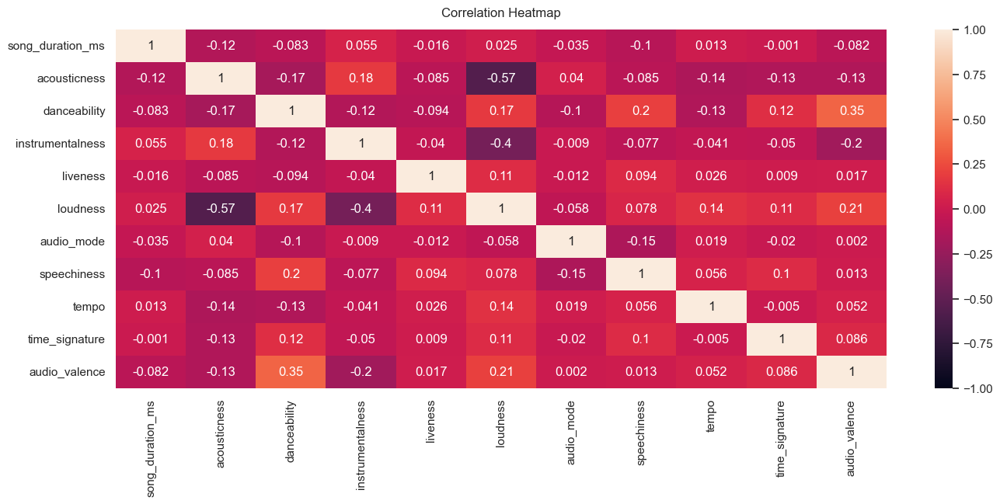

In [487]:
def my_corr(dataframe):
    result = {}
    columns = dataframe.columns
    for column_1 in columns:
        corr_col = {}
        for column_2 in columns:
            method = 'pearson'
            if column_1 in discrete_features or column_2 in discrete_features:
                method = 'spearman'
            corr = dataframe[column_1].corr(dataframe[column_2], method=method)
            corr_col[column_2] = round(corr, 3)
        result[column_1] = pd.Series(corr_col)
    return pd.DataFrame(result)


plt.figure(figsize=(16, 6))
sns.set(font_scale=1)
heatmap = sns.heatmap(my_corr(data), vmin=-1, vmax=1, annot=True)

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12)

In [488]:
new_data = data.drop(columns=['acousticness', 'instrumentalness', 'danceability'])
new_X_train, new_X_test, new_y_train, new_y_test = train_test_split(new_data, target, test_size=0.33, random_state=42)

In [489]:
lin_pipe.fit(new_X_train, new_y_train)
model_results(lin_pipe, new_X_train, new_y_train)

coefs -  [ 1.98905268  2.06203387 15.52993153 -0.19233258  0.12472106  1.71430995
  0.90220762  3.66616179]
Determination coef - 0.6342510872665093
Mean absolute error -  10.712634288597616
Mean squared error -  179.87663262629746
Mean absolute percentage error -  0.5177676000170364


In [490]:
model_results(lin_pipe, new_X_test, new_y_test, show_coefs=False)

Determination coef - 0.6336654360321373
Mean absolute error -  10.781696197714627
Mean squared error -  180.07249129621147
Mean absolute percentage error -  0.4187195483673678


## PCA

In [504]:
data.shape

(14926, 11)

In [505]:
pca = PCA(n_components='mle', svd_solver='full')
pca.fit(data)
pca_data = pca.transform(data)

In [506]:
pca_data.shape

(14926, 10)

In [507]:
X_train, X_test, y_train, y_test = train_test_split(pca_data, target, test_size=0.33, random_state=42)

In [508]:
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train)

coefs -  [ -4.16630798 -16.49839285   1.53257144   0.21184627  -2.37020224
  -0.74508315   6.40719186   1.42711502   3.95352337  -2.21585841]
Determination coef - 0.7387094664908742
Mean absolute error -  9.01092380694988
Mean squared error -  128.50362548855392
Mean absolute percentage error -  0.36846413608489936


In [509]:
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.7376864595088614
Mean absolute error -  9.144892888955633
Mean squared error -  128.94074811109766
Mean absolute percentage error -  0.3063695015179879


## Regularisation analysis

In [497]:
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=0.33, random_state=42)
params = {'lasso__alpha': np.arange(0, 20, 0.5)}
lasso_pipe = Pipeline([('scaler', StandardScaler()), ('lasso', Lasso(random_state=1))])
grid = GridSearchCV(estimator=lasso_pipe, 
                    param_grid=params, 
                    scoring='neg_mean_squared_error')
cv_res = grid.fit(X_train, y_train)
lasso_pipe = cv_res.best_estimator_
lasso_pipe.fit(X_train, y_train)
print('best_params: ', cv_res.best_params_)
model_results(lasso_pipe, X_train, y_train, show_coefs=False)
model_results(lasso_pipe, X_test, y_test)

best_params:  {'lasso__alpha': 0.0}
Determination coef - 0.7421375758861752
Mean absolute error -  8.945390668880217
Mean squared error -  126.81766894067854
Mean absolute percentage error -  0.3632291843266521
coefs -  [ 0.99446203 -7.79532406 -3.90235795  2.20002642  1.44294533 12.54883195
 -0.16404316  0.6691873   0.47806903  0.67846006  5.15899899]
Determination coef - 0.7411598848625107
Mean absolute error -  9.079471571800509
Mean squared error -  127.2333788964965
Mean absolute percentage error -  0.3027205687430515


## Polynomial regression

In [498]:
poly_data = PolynomialFeatures(2, include_bias=False).fit_transform(data)
X_train, X_test, y_train, y_test = train_test_split(poly_data, target, test_size=0.33, random_state=42)
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train, show_coefs=False)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.781069367031649
Mean absolute error -  8.169671429751915
Mean squared error -  107.6708738319234
Mean absolute percentage error -  0.21207889428775578
Determination coef - 0.774373004316852
Mean absolute error -  8.314821929166657
Mean squared error -  110.90740326623474
Mean absolute percentage error -  0.19781365188939357


In [295]:
poly_data = PolynomialFeatures(2, interaction_only=True, include_bias=False).fit_transform(data)
X_train, X_test, y_train, y_test = train_test_split(poly_data, target, test_size=0.33, random_state=42)
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train, show_coefs=False)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.7673683288306191
Mean absolute error -  8.463162939860837
Mean squared error -  114.40909376719718
Mean absolute percentage error -  0.2397915632849246
Determination coef - 0.7631541060703951
Mean absolute error -  8.571871919726565
Mean squared error -  116.42207525065443
Mean absolute percentage error -  0.21660761281741361


In [296]:
poly_data = PolynomialFeatures(3, include_bias=False).fit_transform(data)
X_train, X_test, y_train, y_test = train_test_split(poly_data, target, test_size=0.33, random_state=42)
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train, show_coefs=False)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.8053667642610777
Mean absolute error -  7.6746445381901545
Mean squared error -  95.72132636082037
Mean absolute percentage error -  0.18023085217978765
Determination coef - 0.7568746400067757
Mean absolute error -  8.238188975079025
Mean squared error -  119.50875941673046
Mean absolute percentage error -  0.20488580760318592


In [297]:
poly_data = PolynomialFeatures(3, interaction_only=True, include_bias=False).fit_transform(data)
X_train, X_test, y_train, y_test = train_test_split(poly_data, target, test_size=0.33, random_state=42)
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train, show_coefs=False)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.7809521852881749
Mean absolute error -  8.168832126718584
Mean squared error -  107.72850423542583
Mean absolute percentage error -  0.2102067475111371
Determination coef - 0.7645452873602439
Mean absolute error -  8.525067276690171
Mean squared error -  115.73823729118277
Mean absolute percentage error -  0.2035631644431951


## Multicollinearity for poly features

In [500]:
poly_data.shape

(14926, 77)

Text(0.5, 1.0, 'Correlation Heatmap')

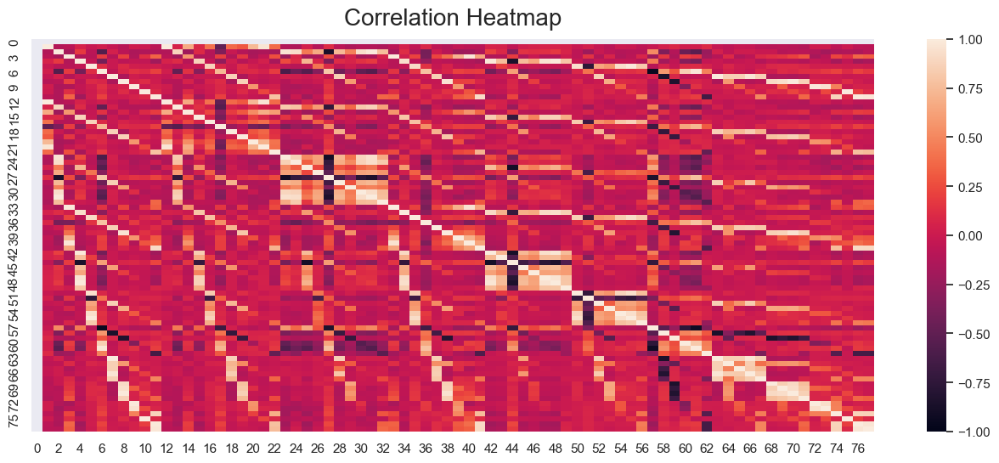

In [299]:
poly_data = pd.DataFrame(PolynomialFeatures(2).fit_transform(data))

def is_discrete(series):
    if series.nunique() <= 0.05*len(series):
        return True
    else:
        return False

def my_corr(dataframe):
    result = {}
    columns = dataframe.columns
    for column_1 in columns:
        corr_col = {}
        for column_2 in columns:
            method = 'pearson'
            if is_discrete(dataframe[column_1]) or is_discrete(dataframe[column_2]):
                method = 'spearman'
            corr = dataframe[column_1].corr(dataframe[column_2], method=method)
            corr_col[column_2] = round(corr, 3)
        result[column_1] = pd.Series(corr_col)
    return pd.DataFrame(result)

plt.figure(figsize=(16, 6))
sns.set(font_scale=1)
corr_matrix = my_corr(poly_data)
heatmap = sns.heatmap(corr_matrix, vmin=-1, vmax=1)

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':20}, pad=12)

In [342]:
new_data = deepcopy(poly_data)

highly_corr = {}
for line in range(len(corr_matrix)):
    for col in range(line):
        if abs(corr_matrix[col][line]) >= 0.9:
            highly_corr[(line, col)] = corr_matrix[col][line]
for key, value in highly_corr.items():
    col = key[0]
    if col in new_data.columns:
        new_data = new_data.drop(columns=[col])
new_data.shape

(14926, 47)

Text(0.5, 1.0, 'Correlation Heatmap')

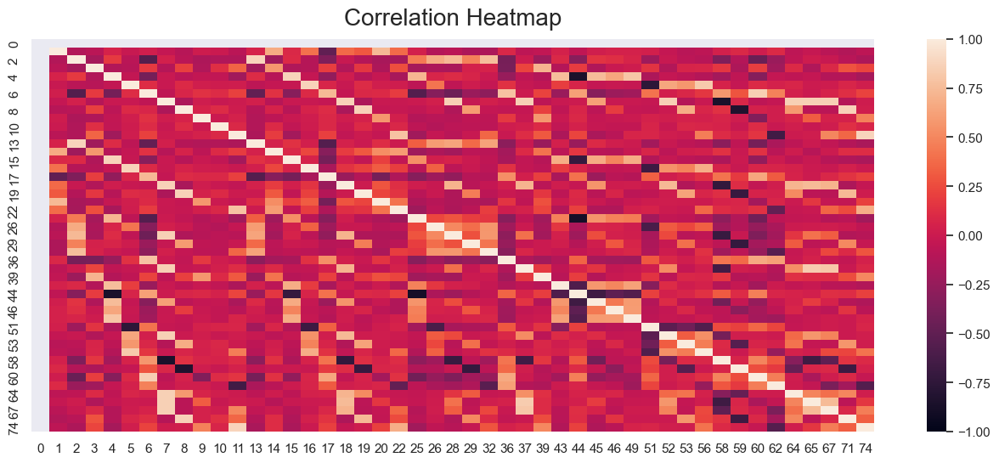

In [343]:
plt.figure(figsize=(16, 6))
sns.set(font_scale=1)

new_corr_matrix = my_corr(new_data)
heatmap = sns.heatmap(new_corr_matrix, vmin=-1, vmax=1)

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':20}, pad=12)

In [344]:
X_train, X_test, y_train, y_test = train_test_split(new_data, target, test_size=0.33, random_state=42)
lin_pipe = Pipeline([('scaler', StandardScaler()), ('reg', LinearRegression())])
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

coefs -  [-2.64335649e-16 -2.77069162e+00 -1.07928771e+01 -5.16576761e+00
  3.95982035e-01  2.42107347e+00  1.09455811e+01 -2.43135717e+00
  1.55615954e+00  1.89740267e+00  6.13209752e-01  4.15385813e+00
  5.36353248e-01  2.22302272e+00  1.06452679e+00 -8.48876549e-01
 -2.92208837e-01  2.57531064e-01  3.93502021e-02  7.25925398e-01
  2.24731640e+00  6.99208328e-01 -3.55512121e-01 -4.25285092e-01
  2.33326377e+00  2.13441464e+00  4.00014065e-01  5.36586805e-01
 -2.76011546e-03  6.03280996e-01 -2.16997390e+00  5.02260529e-01
 -7.83531840e-01 -1.69279891e+00  4.30022855e-01 -1.03036011e-01
  6.52548806e-01 -2.32525280e-01 -5.61067571e-01  1.33422932e+00
  2.35121484e+00 -6.05145616e-01  5.39972768e-01  1.96249175e-01
  1.04950295e+00 -2.18365328e+00 -1.79999227e+00]
Determination coef - 0.7588704784702043
Mean absolute error -  8.651561426217244
Mean squared error -  118.58836718176343
Mean absolute percentage error -  0.26385620576477326
Determination coef - 0.7562549726756179
Mean absol

## PCA for poly features

In [501]:
pd.DataFrame(poly_data).shape

(14926, 77)

In [502]:
pca = PCA(n_components='mle', svd_solver='full')
pca.fit(poly_data)
pca_data = pca.transform(poly_data)

In [503]:
pd.DataFrame(pca_data).shape

(14926, 76)

In [397]:
X_train, X_test, y_train, y_test = train_test_split(pca_data, target, test_size=0.33, random_state=42)
pca_pipe = Pipeline([('scaler', StandardScaler()),  
                     ('lin_reg', LinearRegression())])
pca_pipe.fit(X_train, y_train)
model_results(pca_pipe, X_train, y_train, show_coefs=False)
model_results(pca_pipe, X_test, y_test, show_coefs=False)

Determination coef - 0.7815956553318841
Mean absolute error -  8.162010881865706
Mean squared error -  107.41204335029761
Mean absolute percentage error -  0.20945512437381544
Determination coef - 0.7748944891744729
Mean absolute error -  8.311538798820683
Mean squared error -  110.65106633622206
Mean absolute percentage error -  0.19623635597803116


## Regularisation for poly features


In [406]:
X_train, X_test, y_train, y_test = train_test_split(pca_data, target, test_size=0.33, random_state=42)
params = {'lasso__alpha': np.arange(0, 1, 0.001)}
lasso_pipe = Pipeline([('scaler', StandardScaler()), ('lasso', Lasso(random_state=1))])
grid = GridSearchCV(lasso_pipe, params)
cv_res = grid.fit(X_train, y_train)
lasso_pipe = cv_res.best_estimator_
lasso_pipe.fit(X_train, y_train)
print('Best params: ', cv_res.best_params_)
model_results(lasso_pipe, X_train, y_train, show_coefs=True)
model_results(lasso_pipe, X_test, y_test, show_coefs=False)

Best params:  {'lasso__alpha': 0.031}
coefs -  [  3.50595258 -16.12029479   1.79954331  -0.          -1.72650323
  -3.161543     0.57497166   6.16272642   1.08740709   0.04672716
  -3.67516928  -1.6014238   -0.49103566  -2.09523679   3.74677646
   0.98430021  -0.          -1.03071038   0.85419732   0.7930609
  -0.           0.14545762   1.09263325  -0.21646601   0.35856064
  -0.16476317   0.04496765  -1.1006219    0.52771016   0.20647633
   0.96961147  -0.68065794   1.1758209    0.23693073  -0.38944673
  -0.06963121   0.47872353   0.17019311  -0.21834941  -0.48188008
  -0.5077876    0.62279047   0.37354227  -0.22457636   0.12250563
   0.37994121   0.955334    -0.          -0.39292382   0.66342129
  -0.3258404   -0.09649695  -0.34487562  -0.37283089  -0.24737237
  -0.05166105   0.47031744   1.12194987  -0.23183184  -0.36912529
   0.           0.21936845  -0.29244024   0.13849672   0.25935597
  -0.32278308   0.08571242   0.63764701  -1.12499853  -0.03003565
  -0.78873373   0.03591238  -0

In [407]:
columns_to_drop = []
coefs = lasso_pipe[-1].coef_
for i, coef in enumerate(coefs):
    if np.isclose(coef, 0, atol=0.001):
        columns_to_drop.append(i)
print(columns_to_drop)
lasso_data = pd.DataFrame(pca_data)
lasso_data = lasso_data.drop(columns=columns_to_drop)
lasso_data.shape

[3, 16, 20, 47, 60]


(14926, 71)

In [410]:
X_train, X_test, y_train, y_test = train_test_split(lasso_data, target, test_size=0.33, random_state=42)
lin_pipe.fit(X_train, y_train)
model_results(lin_pipe, X_train, y_train, show_coefs=True)
model_results(lin_pipe, X_test, y_test, show_coefs=False)

coefs -  [  3.53342397 -16.15348226   1.84970518  -1.75355669  -3.189435
   0.61318165   6.19143592   1.12597834   0.11281052  -3.68734435
  -1.63273883  -0.50338717  -2.14492822   3.7775982    1.00897063
  -1.05760162   0.88637032   0.81653104   0.19321295   1.12175174
  -0.24604142   0.37642784  -0.19783921   0.08970974  -1.14310823
   0.55530214   0.24611884   0.98199045  -0.71124683   1.19931703
   0.26604315  -0.42840638  -0.10368648   0.51736073   0.2008542
  -0.25062981  -0.52217405  -0.53935264   0.65614265   0.40143273
  -0.26217854   0.15376743   0.41138295   0.98813851  -0.42788759
   0.69249906  -0.34755575  -0.12642496  -0.37182258  -0.40512154
  -0.27762074  -0.0855828    0.49769779   1.15462248  -0.26498994
  -0.39918252   0.25419803  -0.32699923   0.16919063   0.28572773
  -0.35130151   0.12123852   0.67805321  -1.15323265  -0.06183412
  -0.82097417   0.06390806  -0.39949728  -0.05791881   0.80756097
   0.47981012]
Determination coef - 0.7815939904820204
Mean absolute e

# Step 4. Regression quality

Text(0, 0.5, 'Prediction')

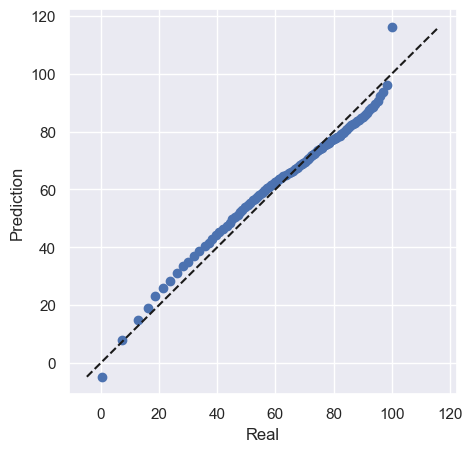

In [411]:
new_data = StandardScaler().fit_transform(pca_data)
X_train, X_test, y_train, y_test = train_test_split(new_data, target, test_size=0.33, random_state=42)
model = LinearRegression().fit(X_train, y_train)

model.fit(X_train, y_train)
y_pred = model.predict(X_test)
percs = np.linspace(0, 100, 100)
qn_first = np.percentile(y_test, percs)
qn_second = np.percentile(y_pred, percs)
plt.figure(figsize=(5, 5))

min_qn = np.min([qn_first.min(), qn_second.min()])
max_qn = np.max([qn_first.max(), qn_second.max()])
x = np.linspace(min_qn, max_qn)

plt.plot(qn_first, qn_second, ls="", marker="o", markersize=6)
plt.plot(x, x, color="k", ls="--")

plt.xlabel(u'Real')
plt.ylabel(u'Prediction')

Text(0, 0.5, 'Predicted values')

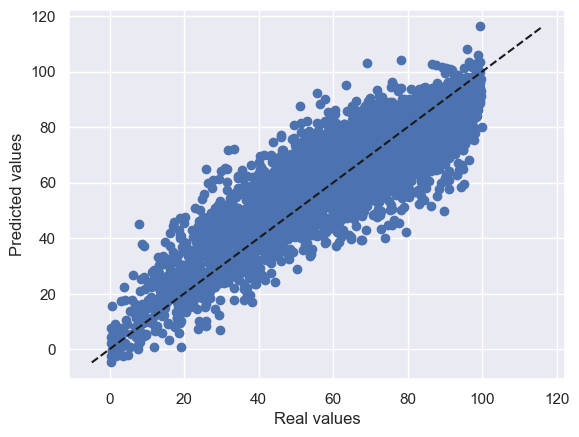

In [412]:
y_pred = model.predict(X_test)

x_min = np.min([np.min(y_test), np.min(y_pred)])
x_max = np.max([np.max(y_test), np.max(y_pred)])
x = np.linspace(x_min, x_max)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test, y_pred)
plt.xlabel('Real values')
plt.ylabel('Predicted values')

## Residues distribution

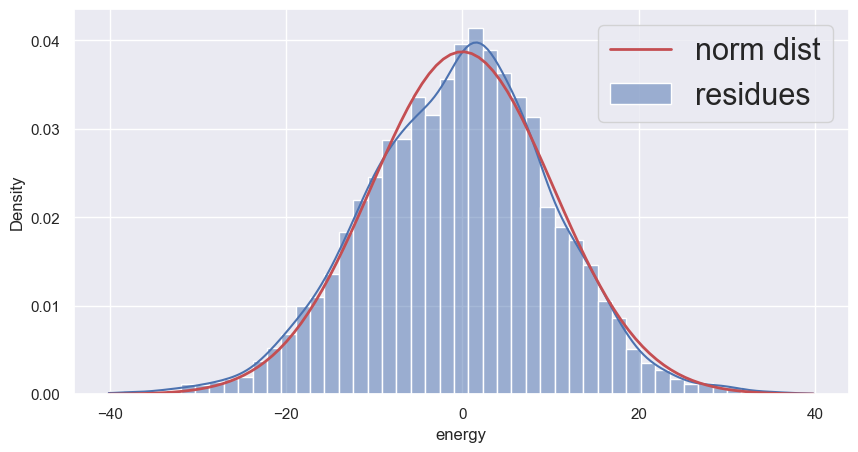

mean:  0
var:  [10.30364418]


In [413]:
y_pred = model.predict(X_test)
residues = y_test - y_pred

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.set(font_scale=2)
plt.rcParams['font.size'] = '20'
sns.histplot(data=residues, kde=True, ax=ax, stat='density', label='residues')


def func(x):
  y_true, bins = np.histogram(residues, bins=300, density=True)
  y_dist = norm.pdf(bins[1:], 0, x)
  return mean_squared_error(y_true, y_dist)
x0=10
ls_var = minimize(func, x0, method='Nelder-Mead',tol=1e-6).x
x = np.linspace(np.min(residues), np.max(residues), 100)
y = norm(0, ls_var).pdf(x)
ax.plot(x, y, 'r-', lw=2, label='norm dist')
plt.legend()
plt.show()

print('mean: ', 0)
print('var: ', ls_var)

### Normality test

In [414]:
print(len(residues))
print(kstest(residues, 'norm', args=(0, ls_var)))

4926
KstestResult(statistic=0.01730184314976324, pvalue=0.10353730849229925)


## Confidence interval

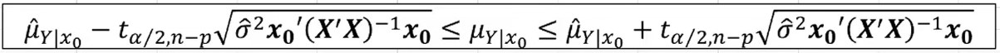
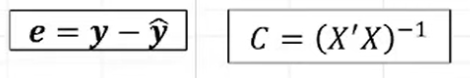
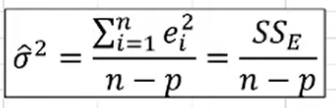
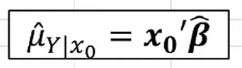

In [415]:
def confidence_interval(p, X, y, y_pred, index):
    sum_sq_residuals = sum((y - y_pred)**2)
    dof = len(X) - p
    mse = sum_sq_residuals / dof
    C = np.linalg.inv(X.T @ X)
            
    alpha = 0.05
    q_t = t(dof).ppf(1-alpha/2)
    if isinstance(X, pd.DataFrame):
        x0 = X.iloc[index]
    else:
        x0 = X[index]
    interval = q_t * np.sqrt(mse * ((x0 @ C) @ x0.T))
    left = y_pred[index] - interval
    right = y_pred[index] + interval
    return left, right


In [416]:
coefs = model.coef_
intercept = model.intercept_
params = np.append(coefs, intercept)
p = len(params)
left = []
right = []
for i in range(len(y_test)):
    int_l, int_r = confidence_interval(p, X_test, y_test, y_pred, i)
    left.append(int_l)
    right.append(int_r)


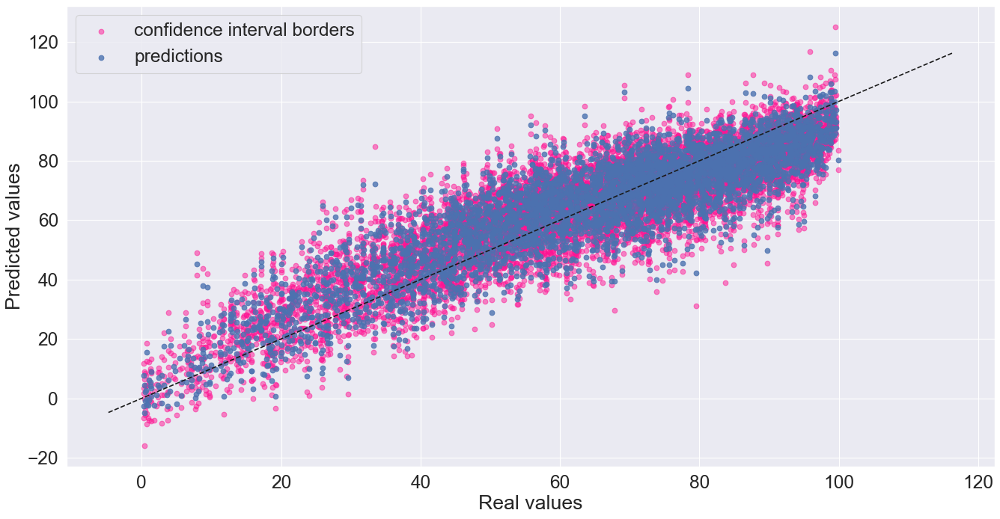

In [417]:
plt.figure(figsize=(20, 10), dpi=80)

x_min = np.min([np.min(y_test), np.min(y_pred)])
x_max = np.max([np.max(y_test), np.max(y_pred)])
x = np.linspace(x_min, x_max)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test.values, left, c='deeppink', alpha=0.5, label='confidence interval borders')
plt.scatter(y_test.values, right, c='deeppink',alpha=0.5)
plt.scatter(y_test, y_pred, alpha=0.8, label='predictions')
plt.xlabel('Real values')
plt.ylabel('Predicted values')
plt.legend()

75    0.025049
44    0.024899
9     0.020474
71    0.019354
8     0.019268
        ...   
24    0.000620
63    0.000578
12    0.000465
1     0.000392
16    0.000056
Length: 76, dtype: float64
Int64Index([75, 44, 9, 71, 8, 56, 40, 70, 15, 47], dtype='int64')


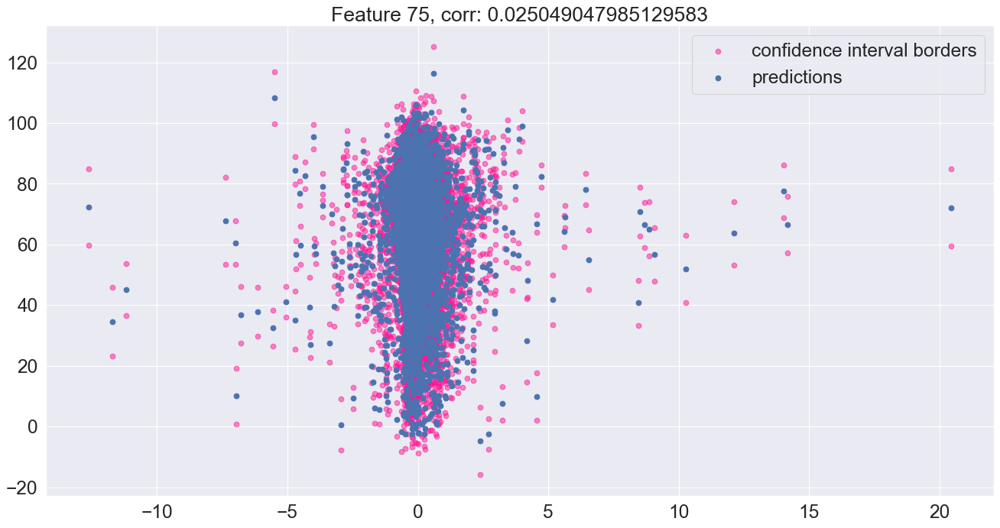

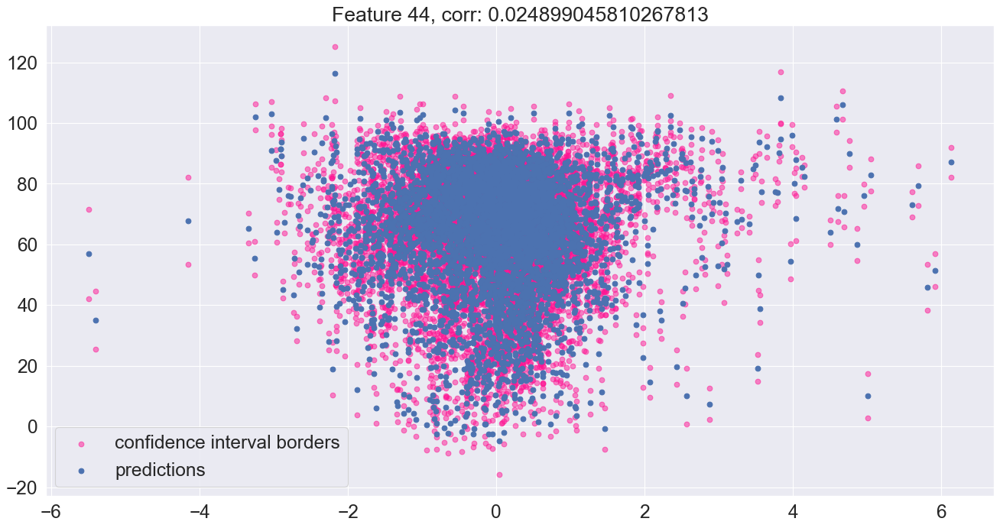

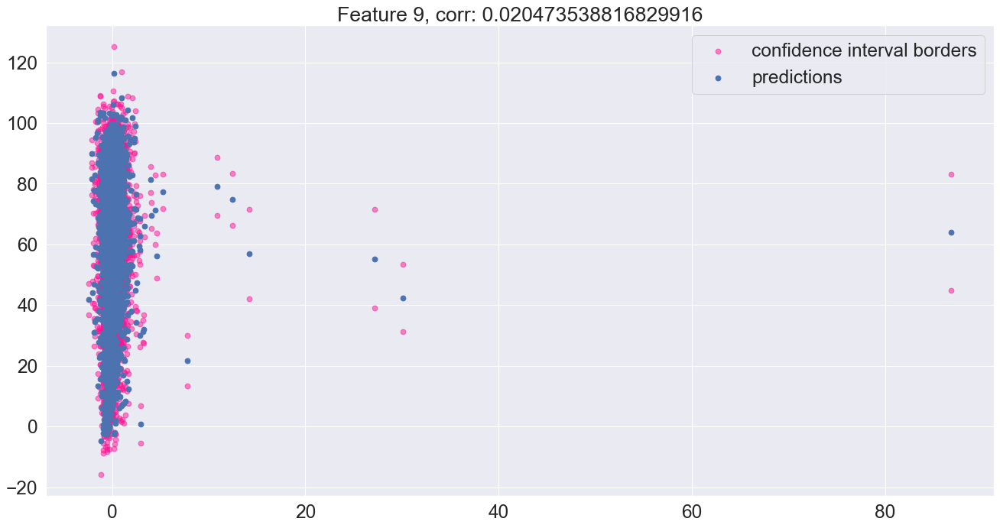

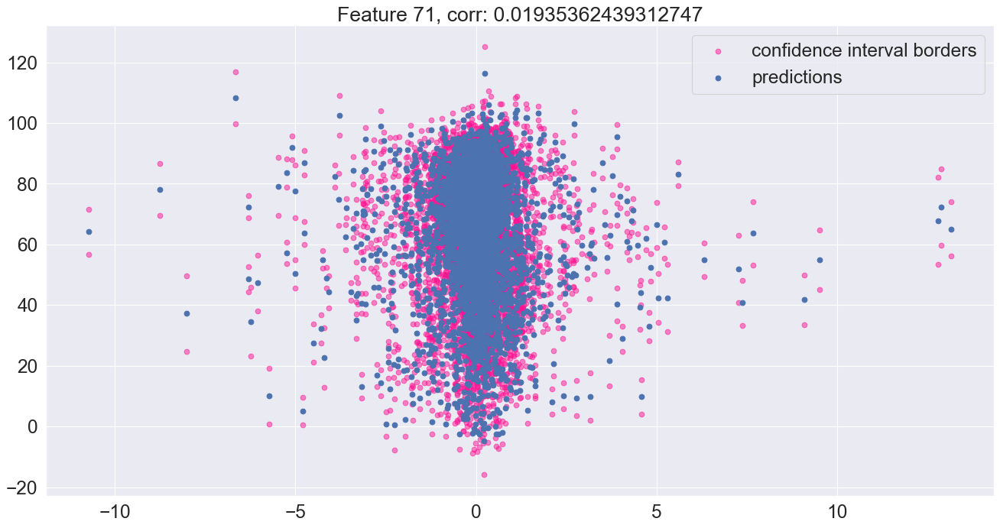

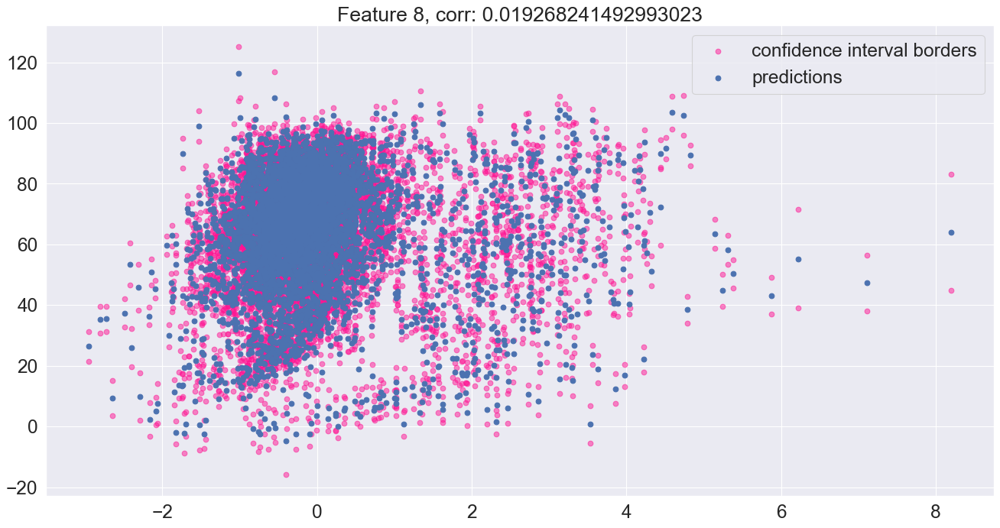

...

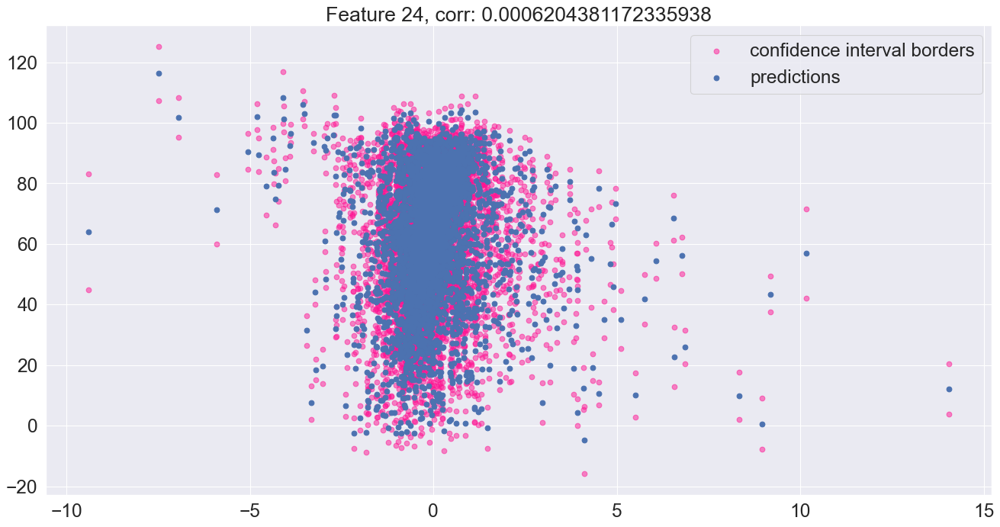

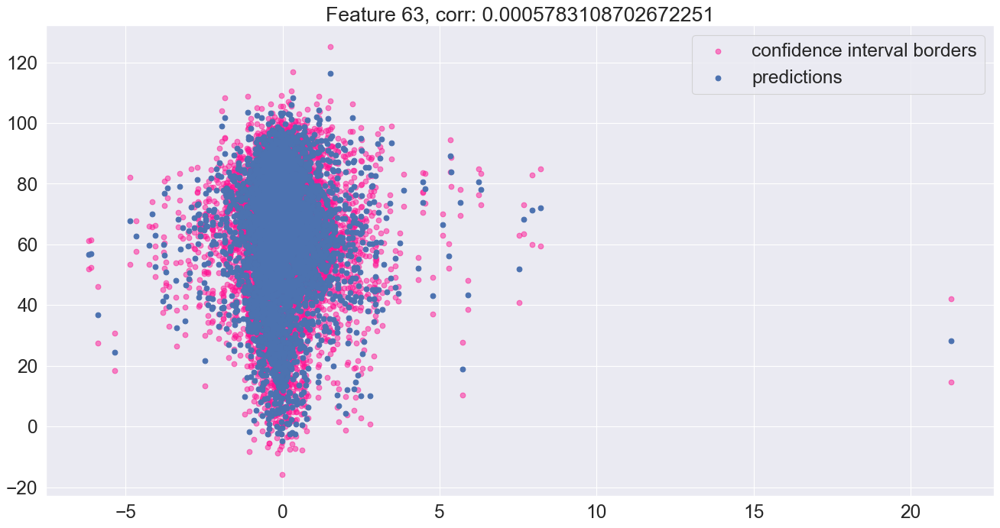

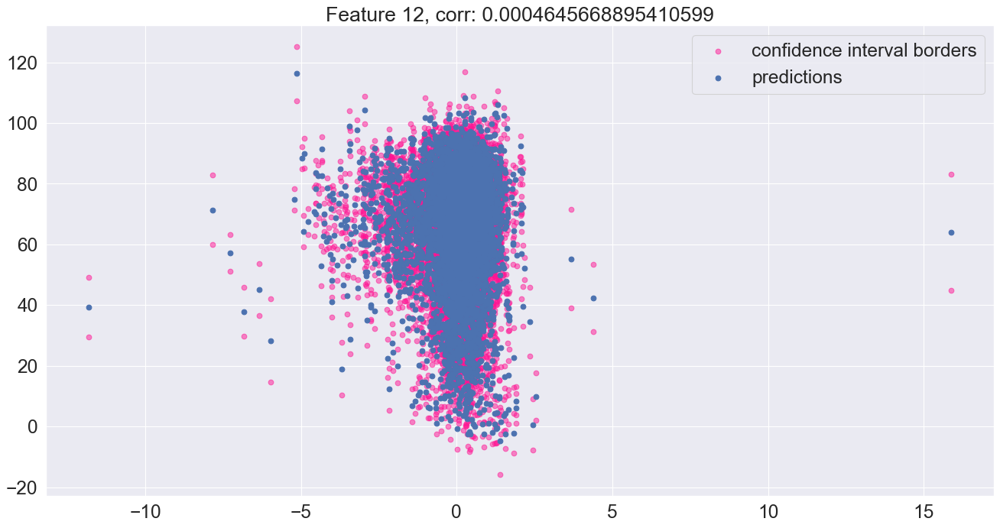

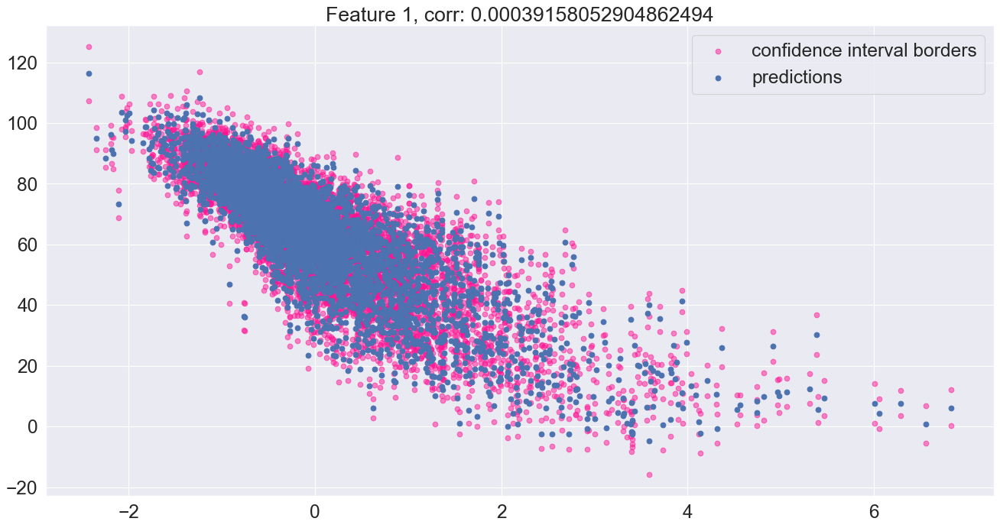

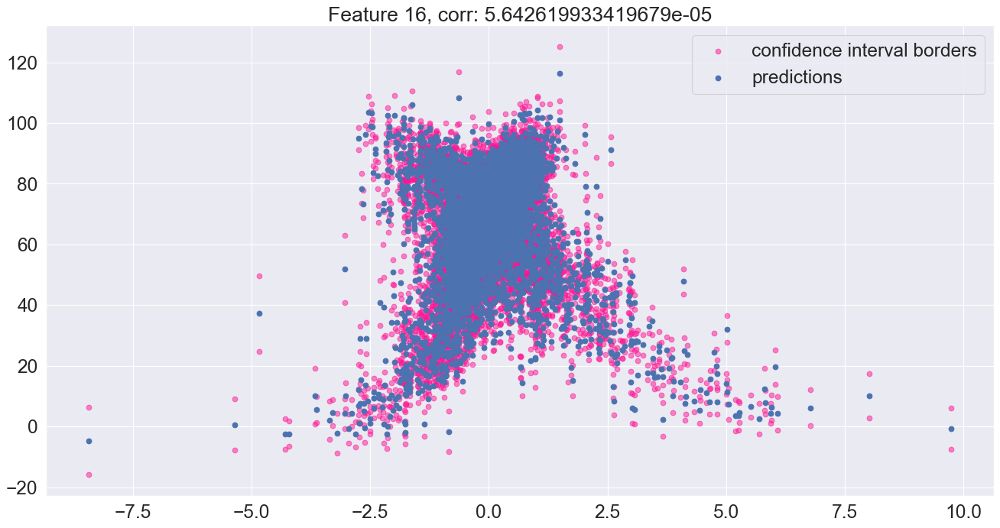

In [421]:
coefs = abs(pd.Series(coefs)).sort_values()
best_preds = coefs[-10:].index

corrs = {}
df_train = pd.DataFrame(X_train)
for col in df_train.columns:
    corrs.update({col: pd.Series(y_train).corr(df_train[col], method='pearson')})
    
corrs = abs(pd.Series(corrs)).sort_values(ascending=False)
best_pred = corrs[:10].index
print(corrs)
print(best_pred)

for pred in corrs.index:
    plt.figure(figsize=(20, 10), dpi=80)
    plt.scatter(X_test[:, pred], left, c='deeppink', alpha=0.5, label='confidence interval borders')
    plt.scatter(X_test[:, pred], right, c='deeppink',alpha=0.5)
    plt.scatter(X_test[:, pred], y_pred, label='predictions')
    plt.title(f'Feature {pred}, corr: {corrs[pred]}')
    plt.legend()
    plt.savefig(f'{corrs[pred]}_{pred}.jpg')
    plt.show()
    

# Step 5-6. Bayesian networks

In [422]:
data['energy'] = target
train_data = data[:round(len(data)*0.67)]
y_train = train_data.energy
train_data

,song_duration_ms,acousticness,danceability,instrumentalness,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence,energy
0,7.0,0.005520,0.496,0.000029,0.0589,-4.095,1,0.0294,167.060,4,0.474,68.2
1,5.0,0.010300,0.542,0.000000,0.1080,-6.407,0,0.0498,105.256,4,0.370,85.3
2,6.0,0.008170,0.737,0.447000,0.2550,-7.828,1,0.0792,123.881,4,0.324,46.3
3,5.0,0.026400,0.451,0.003550,0.1020,-4.938,1,0.1070,122.444,4,0.198,97.0
4,5.0,0.000954,0.447,0.000000,0.1130,-5.065,1,0.0313,172.011,4,0.574,76.6
...,...,...,...,...,...,...,...,...,...,...,...,...
9995,5.0,0.519000,0.688,0.000000,0.3410,-8.227,1,0.1490,84.909,4,0.580,34.8
9996,7.0,0.839000,0.707,0.000007,0.0741,-9.405,0,0.0299,115.026,4,0.286,26.7
9997,5.0,0.577000,0.773,0.000000,0.4750,-8.401,0,0.0531,81.000,4,0.477,40.9
9998,5.0,0.814000,0.714,0.000000,0.0916,-7.971,1,0.0442,110.643,4,0.442,31.1


In [423]:
test_data = data[round(len(data)*0.67):]
y_test = test_data.energy
test_data = test_data.drop(columns=['energy'])
test_data.reset_index(inplace=True, drop=True)
test_data

,song_duration_ms,acousticness,danceability,instrumentalness,liveness,loudness,audio_mode,speechiness,tempo,time_signature,audio_valence
0,5.0,0.5240,0.657,0.000000,0.1060,-5.271,1,0.0306,78.050,4,0.412
1,4.0,0.6410,0.660,0.000012,0.0622,-8.993,1,0.0613,119.934,4,0.324
2,6.0,0.0509,0.381,0.000000,0.1000,-5.820,1,0.0365,123.090,4,0.162
3,4.0,0.1940,0.401,0.000000,0.1240,-5.652,0,0.2080,166.954,4,0.330
4,6.0,0.8090,0.452,0.000172,0.1290,-12.936,0,0.0323,146.605,4,0.191
...,...,...,...,...,...,...,...,...,...,...,...
4921,4.0,0.8930,0.500,0.000065,0.1110,-16.107,1,0.0348,113.969,4,0.300
4922,5.0,0.7650,0.495,0.000001,0.1050,-14.078,0,0.0301,94.286,4,0.265
4923,4.0,0.8470,0.719,0.000000,0.1250,-12.222,1,0.0355,130.534,4,0.286
4924,9.0,0.9450,0.488,0.015700,0.1190,-12.020,1,0.0328,106.063,4,0.323


In [424]:
encoder = preprocessing.LabelEncoder()
discretizer = preprocessing.KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='quantile')

preprocessor = pp.Preprocessor([('encoder', encoder), ('discretizer', discretizer)])
discretized_data, est = preprocessor.apply(train_data)

## First BN

In [425]:
bn = Nets.HybridBN(has_logit=True, use_mixture=True) # init BN
info = preprocessor.info
info

{'types': {'song_duration_ms': 'cont',
  'acousticness': 'cont',
  'danceability': 'cont',
  'instrumentalness': 'cont',
  'liveness': 'cont',
  'loudness': 'cont',
  'audio_mode': 'disc_num',
  'speechiness': 'cont',
  'tempo': 'cont',
  'time_signature': 'disc_num',
  'audio_valence': 'cont',
  'energy': 'cont'},
 'signs': {'song_duration_ms': 'pos',
  'acousticness': 'pos',
  'danceability': 'pos',
  'instrumentalness': 'pos',
  'liveness': 'pos',
  'loudness': 'neg',
  'speechiness': 'pos',
  'tempo': 'pos',
  'audio_valence': 'pos',
  'energy': 'pos'}}

In [426]:
black_list = []
black_list.append(('loudness', 'time_signature'))
black_list.append(('audio_mode', 'instrumentalness'))
params = {'bl_add': black_list,
          'init_nodes': ['song_duration_ms'],
          'init_edges': [('tempo', 'danceability'), ('loudness', 'energy'), ('acousticness', 'liveness'),
                        ('danceability', 'energy'), ('audio_valence', 'danceability'), ('loudness', 'tempo'),
                        ('instrumentalness', 'acousticness')],
          'remove_init_edges': True}

bn.add_nodes(info)
bn.add_edges(discretized_data,  scoring_function=('K2', K2Score), params=params)

In [427]:
bn.get_info()

,name,node_type,data_type,parents,parents_types
0,song_duration_ms,MixtureGaussian,cont,[],[]
1,instrumentalness,MixtureGaussian,cont,[song_duration_ms],[cont]
2,loudness,MixtureGaussian,cont,"[song_duration_ms, instrumentalness]","[cont, cont]"
3,audio_valence,MixtureGaussian,cont,"[song_duration_ms, instrumentalness]","[cont, cont]"
4,energy,MixtureGaussian,cont,"[loudness, audio_valence]","[cont, cont]"
5,time_signature,Logit (LogisticRegression),disc_num,[energy],[cont]
6,tempo,MixtureGaussian,cont,[energy],[cont]
7,danceability,ConditionalMixtureGaussian,cont,"[tempo, audio_valence, time_signature]","[cont, cont, disc_num]"
8,speechiness,MixtureGaussian,cont,"[danceability, tempo, energy]","[cont, cont, cont]"
9,acousticness,MixtureGaussian,cont,"[danceability, energy]","[cont, cont]"


In [428]:
bn.plot('K2_BN.html')

In [429]:
bn.fit_parameters(train_data)

In [453]:
pred = bn.predict(test_data)
pred

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.93it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 63.26it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 45.00it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 102.50it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 111.07it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 124.97it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 131.44it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 71.44it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.05it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.93it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 83.33it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 43.89it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 50.04it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.95it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 47.65it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 110.39it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.00it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 111.13it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 60.42it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 91.01it/s]


2022-11-06 18:27:15,042 | ERROR    | Networks.py-wrapper-0523 | 'energy'


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.91it/s]

2022-11-06 18:27:15,080 | ERROR    | Networks.py-wrapper-0523 | 'energy'



100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 71.37it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 89.09it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 83.29it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 45.45it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 41.66it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 45.44it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 41.66it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 41.64it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 34.49it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 43.50it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 40.02it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 66.69it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 67.99it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 66.62it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 62.50it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 111.18it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 56.85it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 75.82it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.92it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.18it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 73.24it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 125.03it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.94it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 64.24it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 60.83it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 108.43it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 71.35it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.93it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 60.08it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.02it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 66.74it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 91.35it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.93it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.08it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 58.84it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 110.44it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 67.33it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 108.53it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 58.83it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.07it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 74.83it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 100.03it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 55.89it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 71.46it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 83.36it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 41.68it/s]


100%|██████████████████████████████████████████████████████████████████████████████| 4926/4926 [03:31<00:00, 23.28it/s]


{'energy': [75.80143607367613,
  47.84546682450596,
  68.11224710378175,
  71.885903291007,
  33.34574115026032,
  52.395503700893656,
  50.64499066001656,
  48.17590388973921,
  36.04593090420798,
  28.285951300447582,
  41.72982186481352,
  49.561108660752296,
  65.91273119013431,
  65.6794394580403,
  47.8149320983332,
  42.939889417778765,
  72.57855643054604,
  51.10474701343637,
  58.23940504410668,
  50.55317941175092,
  62.60113873387159,
  64.29007864571632,
  68.88870902282011,
  52.87654798030242,
  71.52745346976535,
  74.48260547357187,
  55.29124119964094,
  35.97093884821347,
  56.873134147183485,
  51.541299276138524,
  79.08234524744232,
  53.31470232631036,
  52.622639940524024,
  33.916518006750536,
  53.13780579196176,
  69.79763649135646,
  88.11558474527115,
  65.00605053089139,
  75.27210929134006,
  43.483889710532736,
  57.29119713909265,
  68.37552276958218,
  60.53924064372612,
  54.959737320407136,
  46.73727137913059,
  50.23968472567857,
  78.5148793379754

## Regression quality

In [454]:
y_pred = [v if not math.isnan(v) else np.mean(target) for v in pred['energy']]

print('Determination coef = ', r2_score(y_test, y_pred))
print('Mean absolute error = ', mean_absolute_error(y_test, y_pred))
print('Mean squared error = ', mean_squared_error(y_test, y_pred))
print('Mean absolute percentage error - ', mean_absolute_percentage_error(y_test, y_pred))

Determination coef =  0.6867132726763243
Mean absolute error =  9.664028295826242
Mean squared error =  150.52191219685875
Mean absolute percentage error -  0.29417083572207603


Text(0, 0.5, 'Prediction')

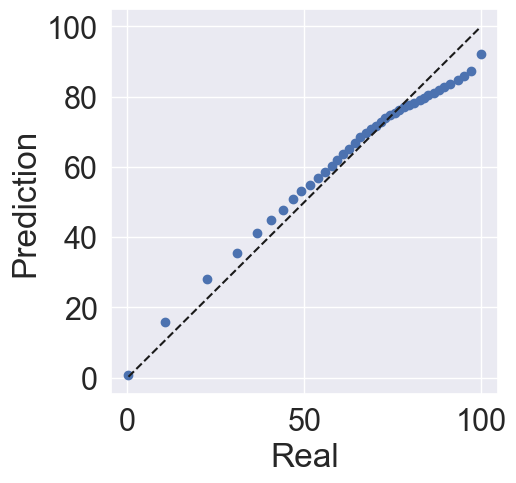

In [455]:
percs = np.linspace(0, 100, 40)
qn_first = np.percentile(y_test, percs)
qn_second = np.percentile(y_pred, percs)
plt.figure(figsize=(5, 5))

min_qn = np.min([qn_first.min(), qn_second.min()])
max_qn = np.max([qn_first.max(), qn_second.max()])
x = np.linspace(min_qn, max_qn)

plt.plot(qn_first, qn_second, ls="", marker="o", markersize=6)
plt.plot(x, x, color="k", ls="--")

plt.xlabel(u'Real')
plt.ylabel(u'Prediction')

Text(0, 0.5, 'Predicted values')

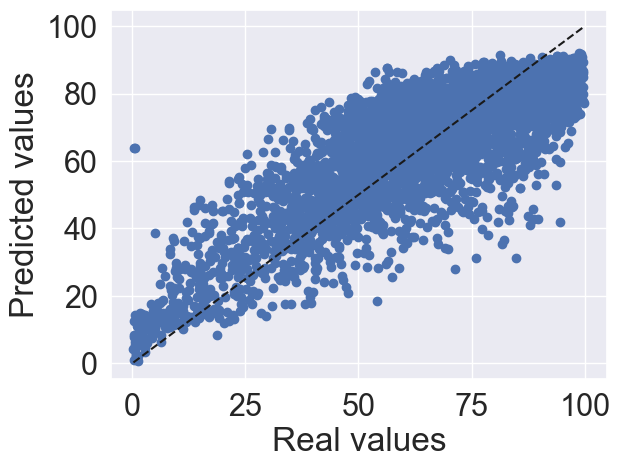

In [456]:
x_min = np.min([np.min(y_test), np.min(y_pred)])
x_max = np.max([np.max(y_test), np.max(y_pred)])
x = np.linspace(x_min, x_max)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test, y_pred)
plt.xlabel('Real values')
plt.ylabel('Predicted values')

### Residues distribution

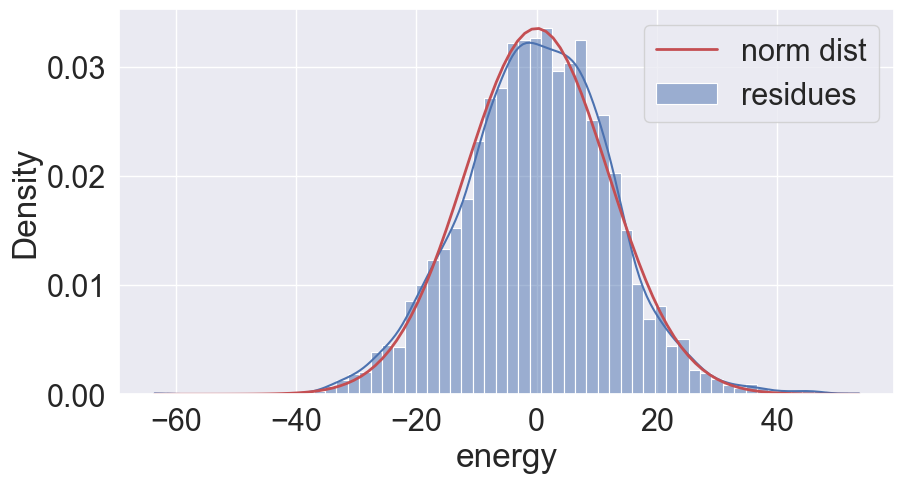

mean:  0
var:  [11.88754463]


In [457]:
residues = y_test - y_pred

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.set(font_scale=2)
plt.rcParams['font.size'] = '20'
sns.histplot(data=residues, kde=True, ax=ax, stat='density', label='residues')


def func(x):
  y_true, bins = np.histogram(residues, bins=300, density=True)
  y_dist = norm.pdf(bins[1:], 0, x)
  return mean_squared_error(y_true, y_dist)
x0=10
ls_var = minimize(func, x0, method='Nelder-Mead',tol=1e-6).x
x = np.linspace(np.min(residues), np.max(residues), 100)
y = norm(0, ls_var).pdf(x)
ax.plot(x, y, 'r-', lw=2, label='norm dist')
plt.legend()
plt.show()

print('mean: ', 0)
print('var: ', ls_var)

In [458]:
print(len(residues))
print(kstest(residues, 'norm', args=(0, ls_var)))

4926
KstestResult(statistic=0.016860433767997063, pvalue=0.12014803608591929)


### Confidence intervals

In [459]:
n_means = sum([len(x) for x in bn.distributions['energy']['mean']])
n_coefs = len(bn.distributions['energy']['coef'])
n_covars = 0
for x in bn.distributions['energy']['covars']:
    for y in x:
        n_covars += len(y)
p = n_means + n_coefs + n_covars
p

130

In [460]:
left = []
right = []
for i in range(len(y_test)):
    int_l, int_r = confidence_interval(p, test_data, y_test, y_pred, i)
    left.append(int_l)
    right.append(int_r)

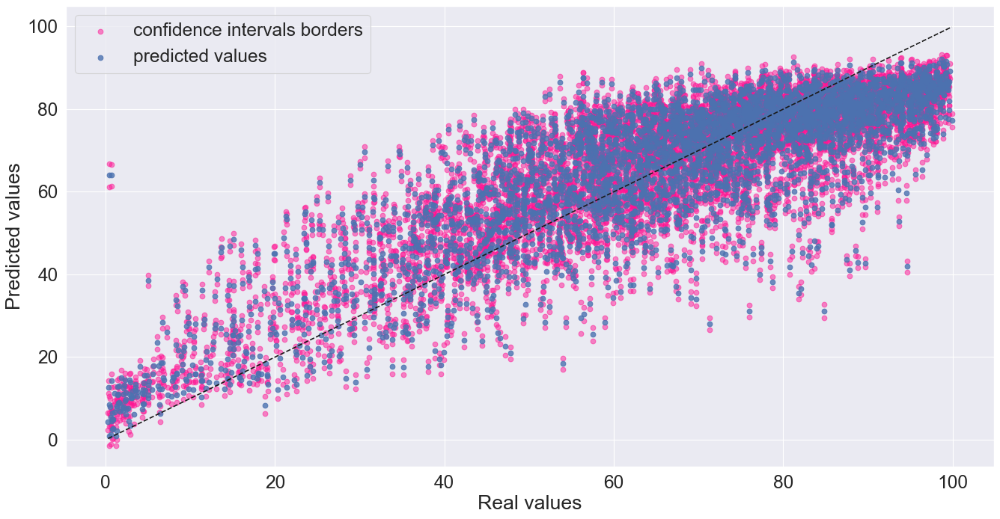

In [461]:
plt.figure(figsize=(20, 10), dpi=80)

x_min = np.min([np.min(y_test), np.min(y_pred)])
x_max = np.max([np.max(y_test), np.max(y_pred)])
x = np.linspace(x_min, x_max)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test.values, left, c='deeppink', alpha=0.5, label='confidence intervals borders')
plt.scatter(y_test.values, right, c='deeppink',alpha=0.5)
plt.scatter(y_test, y_pred, alpha=0.8, label='predicted values')
plt.xlabel('Real values')
plt.ylabel('Predicted values')
plt.legend()

## Second BN

In [439]:
bn_1 = Nets.HybridBN(has_logit=True, use_mixture=True) # init BN
info = preprocessor.info
info

{'types': {'song_duration_ms': 'cont',
  'acousticness': 'cont',
  'danceability': 'cont',
  'instrumentalness': 'cont',
  'liveness': 'cont',
  'loudness': 'cont',
  'audio_mode': 'disc_num',
  'speechiness': 'cont',
  'tempo': 'cont',
  'time_signature': 'disc_num',
  'audio_valence': 'cont',
  'energy': 'cont'},
 'signs': {'song_duration_ms': 'pos',
  'acousticness': 'pos',
  'danceability': 'pos',
  'instrumentalness': 'pos',
  'liveness': 'pos',
  'loudness': 'neg',
  'speechiness': 'pos',
  'tempo': 'pos',
  'audio_valence': 'pos',
  'energy': 'pos'}}

In [440]:
black_list = []
black_list.append(('loudness', 'time_signature'))
black_list.append(('audio_mode', 'instrumentalness'))
params = {'bl_add': black_list,
          'init_nodes': ['song_duration_ms'],
         'init_edges': [('tempo', 'danceability'), ('loudness', 'energy'), ('acousticness', 'liveness'),
                        ('danceability', 'energy'), ('audio_valence', 'danceability'), ('loudness', 'tempo'),
                        ('instrumentalness', 'acousticness')],
         'remove_init_edges': True}

bn_1.add_nodes(info)
bn_1.add_edges(discretized_data,  scoring_function=('BIC',), params=params)

In [441]:
bn_1.get_info()

,name,node_type,data_type,parents,parents_types
0,song_duration_ms,MixtureGaussian,cont,[],[]
1,time_signature,Logit (LogisticRegression),disc_num,[song_duration_ms],[cont]
2,instrumentalness,ConditionalMixtureGaussian,cont,"[song_duration_ms, time_signature]","[cont, disc_num]"
3,acousticness,ConditionalMixtureGaussian,cont,"[song_duration_ms, instrumentalness, time_sign...","[cont, cont, disc_num]"
4,speechiness,ConditionalMixtureGaussian,cont,"[song_duration_ms, acousticness, time_signature]","[cont, cont, disc_num]"
5,loudness,ConditionalMixtureGaussian,cont,"[speechiness, acousticness, time_signature]","[cont, cont, disc_num]"
6,liveness,MixtureGaussian,cont,"[speechiness, acousticness, loudness]","[cont, cont, cont]"
7,tempo,ConditionalMixtureGaussian,cont,"[speechiness, loudness, time_signature]","[cont, cont, disc_num]"
8,audio_mode,Logit (LogisticRegression),disc_num,"[speechiness, loudness, liveness]","[cont, cont, cont]"
9,audio_valence,ConditionalMixtureGaussian,cont,"[speechiness, loudness, audio_mode]","[cont, cont, disc_num]"


In [442]:
bn_1.plot('BIC_BN.html')

In [443]:
bn_1.fit_parameters(train_data)

In [462]:
pred = bn_1.predict(test_data)
pred

100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 99.97it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 55.50it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 78.54it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 50.00it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 145.97it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 98.50it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 47.60it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 62.82it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.92it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 38.43it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.94it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.89it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 200.05it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 67.75it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 55.56it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 43.44it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 124.28it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 58.78it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.88it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 50.00it/s]

2022-11-06 18:31:31,793 | ERROR    | Networks.py-wrapper-0523 | 'energy'



100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 47.62it/s]

2022-11-06 18:31:31,861 | ERROR    | Networks.py-wrapper-0523 | 'energy'



100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.89it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.92it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 99.98it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.70it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.92it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 96.79it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 111.96it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 83.34it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 141.91it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 66.68it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.67it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 114.43it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 99.92it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 67.58it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 83.66it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.89it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 111.12it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 124.88it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 42.90it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.96it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 43.46it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 78.52it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 90.58it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 47.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 47.62it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 76.88it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 52.63it/s]


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 45.53it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.84it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.44it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.38it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.17it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.06it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.36it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.94it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 328.45it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.03it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.12it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.25it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.00it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 335.14it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.78it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.06it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.96it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.97it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.88it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 250.03it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.87it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 249.88it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.60it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 199.90it/s]


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 333.57it/s]


100%|██████████████████████████████████████████████████████████████████████████████| 4926/4926 [02:47<00:00, 29.49it/s]


{'energy': [70.9422270458671,
  58.74373491442317,
  71.23200640763729,
  82.62079358346685,
  34.46814165228275,
  58.07321545116423,
  49.099776200025445,
  48.197223081137395,
  44.04670211717946,
  31.488115041793648,
  54.93137319693552,
  54.33451402928534,
  71.03025574506673,
  53.06465551326334,
  60.85685749638038,
  55.83333545293771,
  78.16899957055583,
  57.18566561868931,
  57.33681276976808,
  51.22789700477418,
  68.22901891152934,
  59.03652287097859,
  70.7176662702839,
  61.653369923264265,
  67.81697528543471,
  66.68233629532808,
  56.28387835836124,
  46.65445292812276,
  59.2665270886369,
  60.9607261061111,
  77.50470568617162,
  50.12307697767232,
  55.72352071836799,
  45.64205239238696,
  64.55618900997615,
  64.13598874265861,
  91.30911547580558,
  55.16453826544501,
  79.84790515995599,
  48.39443566953322,
  61.514061379776315,
  66.83123395429962,
  61.555380411299815,
  62.97546020788047,
  54.386338700309445,
  60.80967617431731,
  73.5817472944025,
 

### Regression quality

In [463]:
y_pred = [v if not math.isnan(v) else np.mean(data.energy) for v in pred['energy']]

print('Determination coef = ', r2_score(y_test, y_pred))
print('Mean absolute error = ', mean_absolute_error(y_test, y_pred))
print('Mean squared error = ', mean_squared_error(y_test, y_pred))
print('Mean absolute percentage error - ', mean_absolute_percentage_error(y_test, y_pred))

Determination coef =  0.6867630069099212
Mean absolute error =  9.556882472008423
Mean squared error =  150.4980168598089
Mean absolute percentage error -  0.29721493104300784


Text(0, 0.5, 'Prediction')

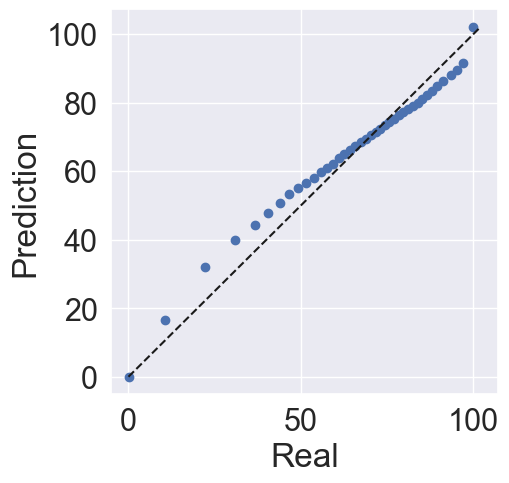

In [446]:
percs = np.linspace(0, 100, 40)
qn_first = np.percentile(y_test, percs)
qn_second = np.percentile(y_pred, percs)
plt.figure(figsize=(5, 5))

min_qn = np.min([qn_first.min(), qn_second.min()])
max_qn = np.max([qn_first.max(), qn_second.max()])
x = np.linspace(min_qn, max_qn)

plt.plot(qn_first, qn_second, ls="", marker="o", markersize=6)
plt.plot(x, x, color="k", ls="--")

plt.xlabel(u'Real')
plt.ylabel(u'Prediction')

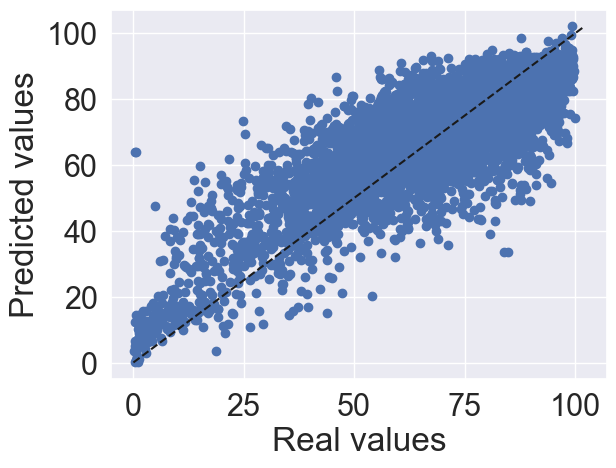

In [447]:
min_qn = np.min([qn_first.min(), qn_second.min()])
max_qn = np.max([qn_first.max(), qn_second.max()])
x = np.linspace(min_qn, max_qn)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test, y_pred)
plt.xlabel('Real values')
plt.ylabel('Predicted values')
plt.show()

### Residues distribution

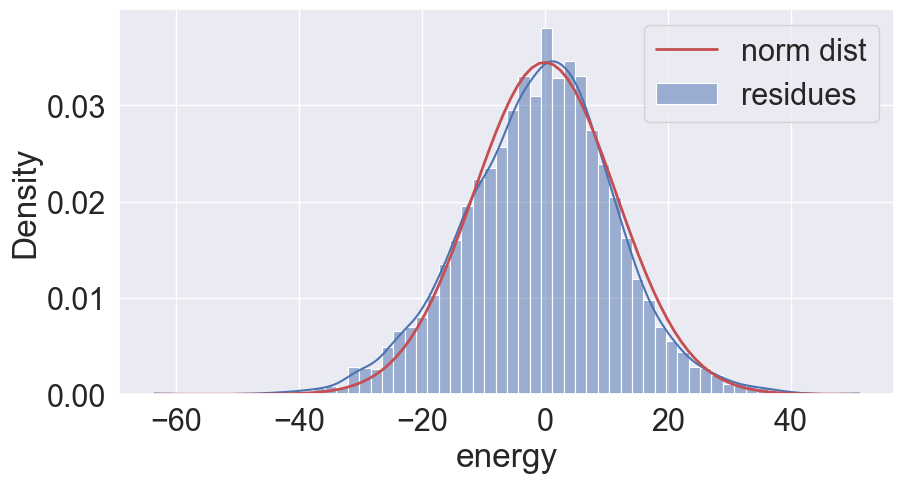

mean:  0
var:  [11.57287502]


In [448]:
residues = y_test - y_pred

fig, ax = plt.subplots(1, 1, figsize=(10, 5))
sns.set(font_scale=2)
plt.rcParams['font.size'] = '20'
sns.histplot(data=residues, kde=True, ax=ax, stat='density', label='residues')


def func(x):
  y_true, bins = np.histogram(residues, bins=300, density=True)
  y_dist = norm.pdf(bins[1:], 0, x)
  return mean_squared_error(y_true, y_dist)
x0=10
ls_var = minimize(func, x0, method='Nelder-Mead',tol=1e-6).x
x = np.linspace(np.min(residues), np.max(residues), 100)
y = norm(0, ls_var).pdf(x)
ax.plot(x, y, 'r-', lw=2, label='norm dist')
plt.legend()
plt.show()

print('mean: ', 0)
print('var: ', ls_var)

In [449]:
print(len(residues))
print(kstest(residues, 'norm', args=(0, ls_var)))

4926
KstestResult(statistic=0.030603719278417707, pvalue=0.00019238206167449077)


### Confidence interval

In [450]:
n_means = sum([len(x) for x in bn_1.distributions['energy']['mean']])
n_coefs = len(bn_1.distributions['energy']['coef'])
n_covars = 0
for x in bn_1.distributions['energy']['covars']:
    for y in x:
        n_covars += len(y)
p = n_means + n_coefs + n_covars
p

210

In [451]:
left = []
right = []
for i in range(len(y_test)):
    int_l, int_r = confidence_interval(p, test_data, y_test, y_pred, i)
    left.append(int_l)
    right.append(int_r)

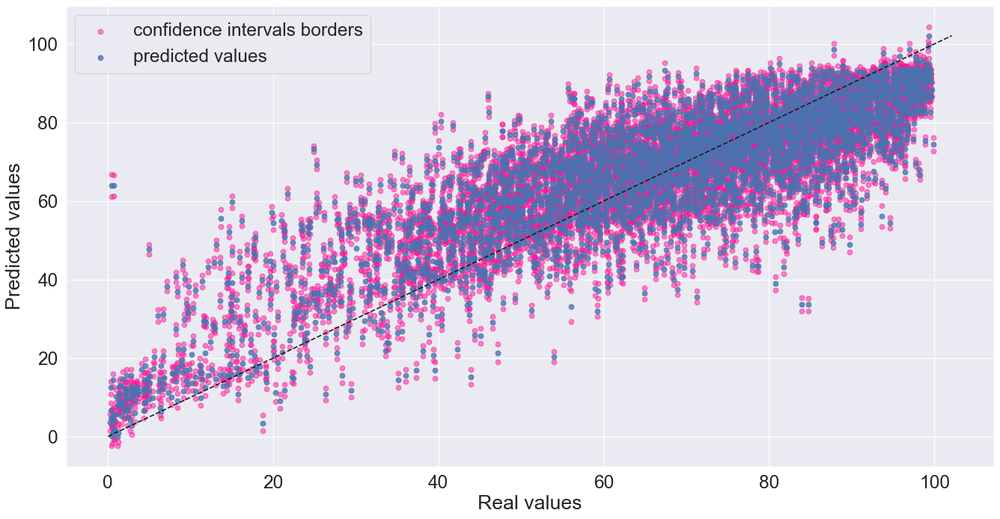

In [452]:
plt.figure(figsize=(20, 10), dpi=80)

x_min = np.min([np.min(y_test), np.min(y_pred)])
x_max = np.max([np.max(y_test), np.max(y_pred)])
x = np.linspace(x_min, x_max)

plt.plot(x, x, color="k", ls="--")

plt.scatter(y_test.values, left, c='deeppink', alpha=0.5, label='confidence intervals borders')
plt.scatter(y_test.values, right, c='deeppink',alpha=0.5)
plt.scatter(y_test, y_pred, alpha=0.8, label='predicted values')
plt.xlabel('Real values')
plt.ylabel('Predicted values')
plt.legend()